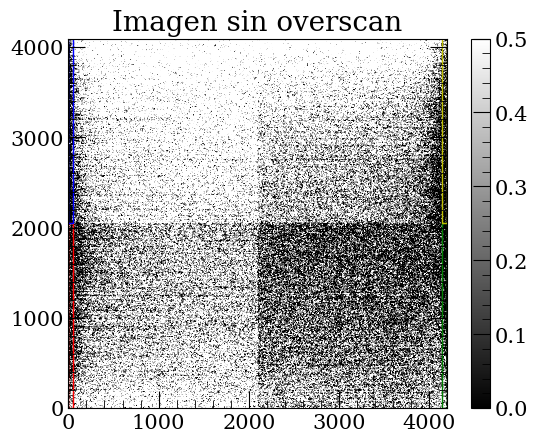

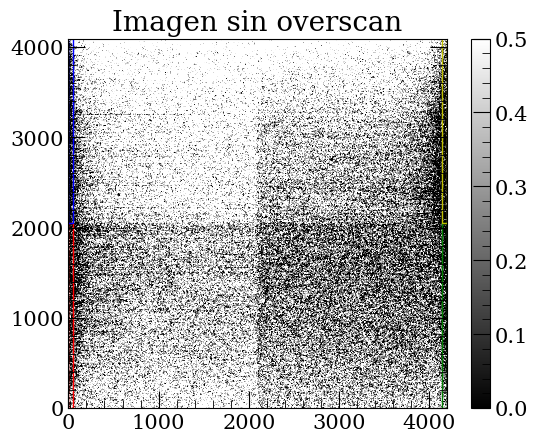

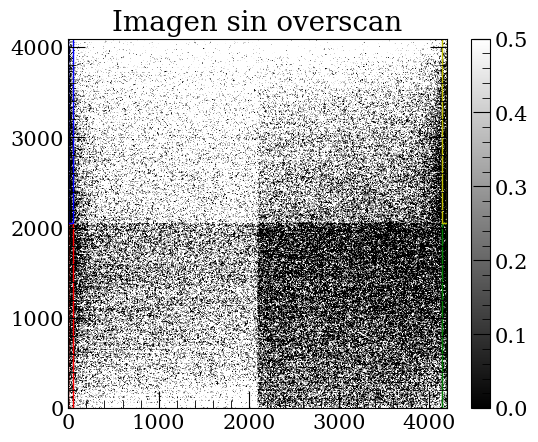

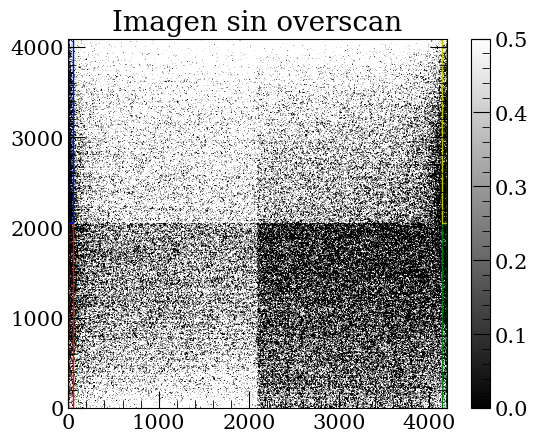

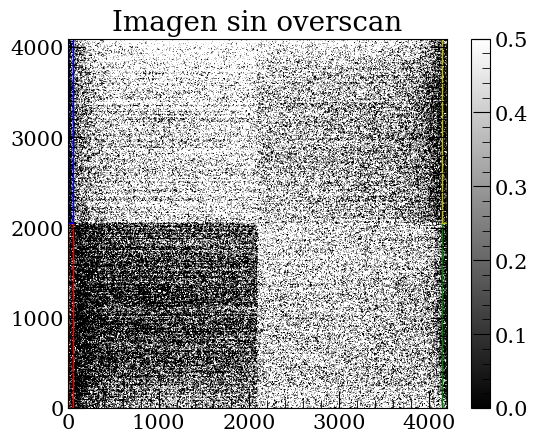

...

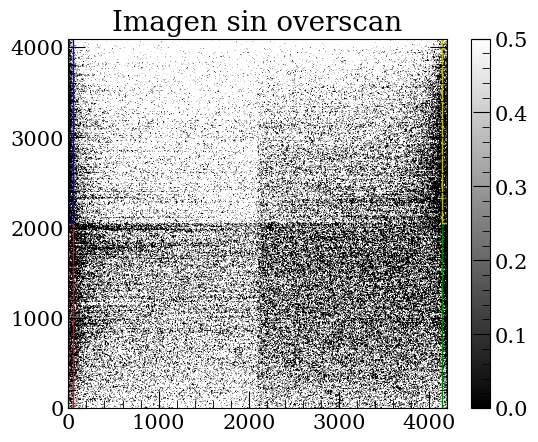

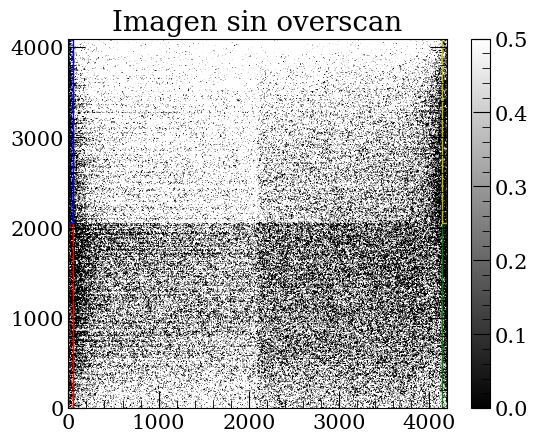

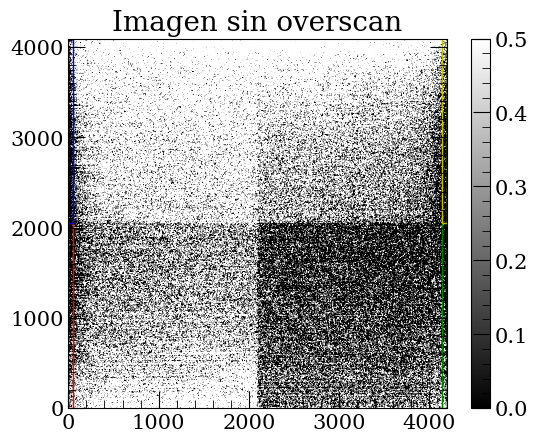

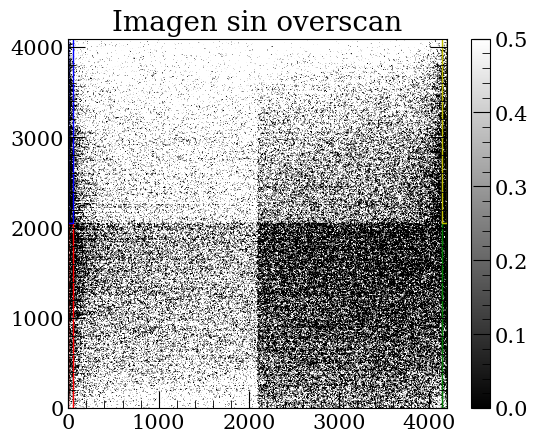

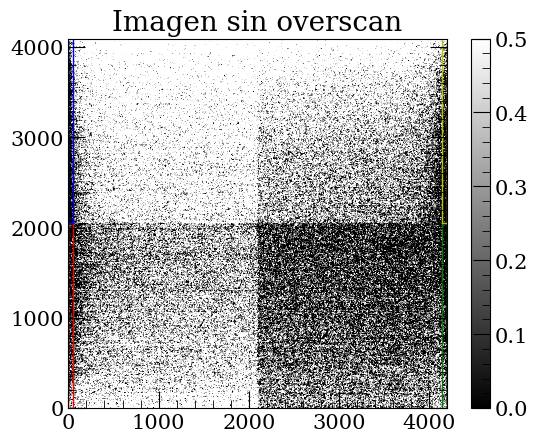

In [2]:
import matplotlib.pyplot as plt
from astropy.io import fits
import numpy as np
import glob

from astropy.stats import sigma_clipped_stats


# Ruta Donde esta los archivos fits.
# Remplazar por el directorio 
ruta_directorio = '/Users/diegogonzalez/Library/Mobile Documents/com~apple~CloudDocs/Documents/observaciones/Draguito/'

# llama los archivos en los cuales se desea trabajar en este caso los  '*b.fits'
archivos_fits = glob.glob(f'{ruta_directorio}/*b.fits')

# Archivo de salida donde guardara la informacion requerida para toda la imagen
#archivo_salida = open('datos_full_image.txt', 'w')

# Genera los archivos de salida para cada seccion que en este caso son 4 divisiones.
archivo_salida1 = open('datos_sin_over1.txt', 'w')
archivo_salida2 = open('datos_sin_over2.txt', 'w')
archivo_salida3 = open('datos_sin_over3.txt', 'w')
archivo_salida4 = open('datos_sin_over4.txt', 'w')

# Esta linea escribe el encabezado de los datos de salida requeridos
#archivo_salida.write('Archivo FITS\tMJD\tstd_dev\tmedian\taverage\n')

# Escribir el archivo de salida para la parte 1
archivo_salida1.write('Archivo FITS\tMJD\tstd_dev1\tmedian1\tmean1\n')

# Escribir el archivo de salida para la parte 2
archivo_salida2.write('Archivo FITS\tMJD\tstd_dev2\tmedian2\tmean2\n')

# Escribir el archivo de salida para la parte 3
archivo_salida3.write('Archivo FITS\tMJD\tstd_dev3\tmedian3\tmean3\n')

# Escribir el archivo de salida para la parte 3
archivo_salida4.write('Archivo FITS\tMJD\tstd_dev4\tmedian4\tmean4\n')


# ser realizara el proceso para todas las imagenes
for archivo_fits in archivos_fits:
    # Lee la imagen FITS
    hdulist = fits.open(archivo_fits)
    imagen_bias = hdulist[0].data

    # aqui calculamos los percentiles 1 y 99 para definir vmin y vmax
    # podemos cambiar los valores
    vmin = np.percentile(imagen_bias, 1)
    vmax = np.percentile(imagen_bias, 99)

    # Tamaño de cada region en pixeles 
    parte1 = imagen_bias[0:2048, 0:2096]
    parte2 = imagen_bias[0:2048, 2096:4192]
    parte3 = imagen_bias[2048:4096, 0:2096]
    parte4 = imagen_bias[2048:4096, 2096:4192]
    
    # Tamaño de los overscan para cada seccion 
    overscan1 = imagen_bias[1:2048, 1:48]
    overscan2 = imagen_bias[1:2048, 4144:4192]
    overscan3 = imagen_bias[2048:4096, 1:48]
    overscan4 = imagen_bias[2048:4096, 4144:4292]
    
    # mediana del overscan de cada seccion con sigma_clipped_stats (sugerencia Alan)
    Amean1, Amedian1, Astd1 = sigma_clipped_stats(overscan1)
    Amean2, Amedian2, Astd2 = sigma_clipped_stats(overscan2)
    Amean3, Amedian3, Astd3 = sigma_clipped_stats(overscan3)
    Amean4, Amedian4, Astd4 = sigma_clipped_stats(overscan4)

    # restamos el overscan a cada imagen por el promedio sugerido Alan
    parte1_sin_overscan = parte1 - Amean1
    parte2_sin_overscan = parte2 - Amean2
    parte3_sin_overscan = parte3 - Amean3
    parte4_sin_overscan = parte4 - Amean4

    # Union de las imagenes sin overscan 
    imagen_sin_overscan = np.vstack((np.hstack((parte1_sin_overscan, parte2_sin_overscan)), np.hstack((parte3_sin_overscan, parte4_sin_overscan))))
    
    #calculamos la media, median y std_dev para cada una de las partes
    #average, median, std_dev = sigma_clipped_stats(overscan1)
    mean1, median1, std_dev1 = sigma_clipped_stats(parte1_sin_overscan)
    mean2, median2, std_dev2 = sigma_clipped_stats(parte2_sin_overscan)
    mean3, median3, std_dev3 = sigma_clipped_stats(parte3_sin_overscan)
    mean4, median4, std_dev4 = sigma_clipped_stats(parte4_sin_overscan)

    # Obtemos el MJD del encabezado de cada FITS
    mjd = hdulist[0].header['MJD']
    
    #graficamos un rectangulo que muestre la region del overcan para cada region
    rect1 = plt.Rectangle((1, 1), overscan1.shape[1], overscan1.shape[0], linewidth=1, edgecolor='r', facecolor='none')
    rect2 = plt.Rectangle((4144, 1), overscan2.shape[1], overscan2.shape[0], linewidth=1, edgecolor='g', facecolor='none')
    rect3 = plt.Rectangle((1, 2048), overscan3.shape[1], overscan3.shape[0], linewidth=1, edgecolor='b', facecolor='none')
    rect4 = plt.Rectangle((4144, 2048), overscan4.shape[1], overscan4.shape[0], linewidth=1, edgecolor='y', facecolor='none')
    
    plt.gca().add_patch(rect1)
    plt.gca().add_patch(rect2)
    plt.gca().add_patch(rect3)
    plt.gca().add_patch(rect4)
    
    # Graficamos la imagen resultante sin overscan
    plt.imshow(imagen_sin_overscan, cmap='gray', origin='lower', vmin=0.0, vmax=0.5)
    plt.title("Imagen sin overscan")
    plt.colorbar()
    plt.show()

    # Cerrar el archivo FITS
    hdulist.close()
    

    # Escribir los resultados en el archivo de salida
    #archivo_salida.write(f'{archivo_fits}\t{mjd}\t{std_dev}\t{median}\t{average}\n')

    # Escribimos los resultados en los archivos de salida para cada region
    # entre ellos estan: nombre de l archivo, mjd, std_dev, median y mean (o average)
    archivo_salida1.write(f'{archivo_fits}\t{mjd}\t{std_dev1}\t{median1}\t{mean1}\n')
    archivo_salida2.write(f'{archivo_fits}\t{mjd}\t{std_dev2}\t{median2}\t{mean2}\n')
    archivo_salida3.write(f'{archivo_fits}\t{mjd}\t{std_dev3}\t{median3}\t{mean3}\n')
    archivo_salida4.write(f'{archivo_fits}\t{mjd}\t{std_dev4}\t{median4}\t{mean4}\n')

    # Cerrar el archivo FITS
    hdulist.close()

# Cerrar el archivo de salida
archivo_salida1.close()
archivo_salida2.close()
archivo_salida3.close()
archivo_salida4.close()


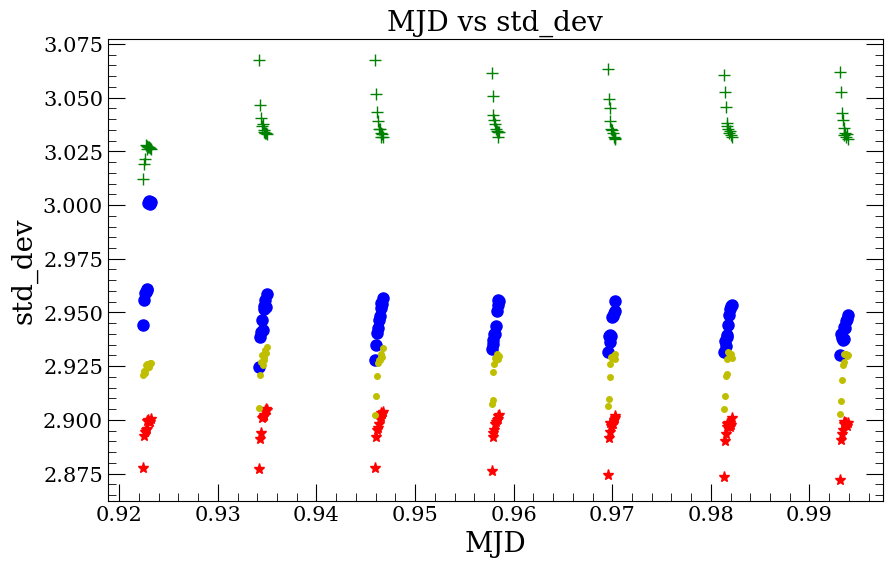

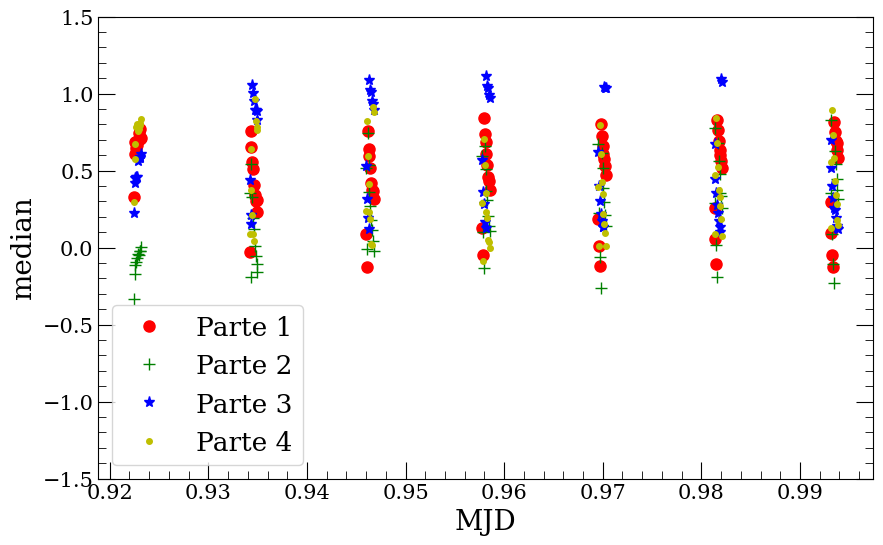

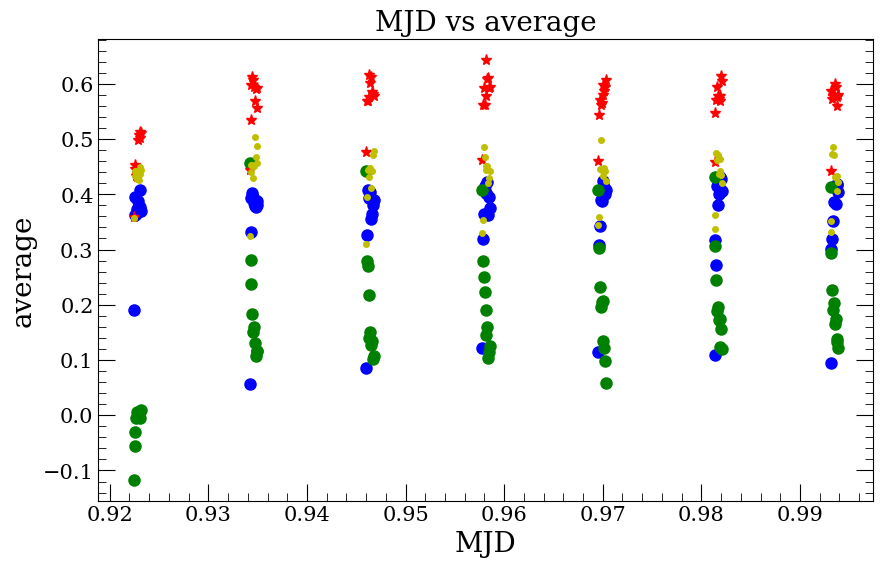

In [6]:
# Leer el archivo info_sin_over.txt
data1 = np.loadtxt('datos_sin_over1.txt', delimiter='\t', skiprows=1, usecols=(1, 2, 3, 4))
mjd1 = data1[:, 0]
std_dev1 = data1[:, 1]
median1 = data1[:, 2]
average1 = data1[:, 3]

data2 = np.loadtxt('datos_sin_over2.txt', delimiter='\t', skiprows=1, usecols=(1, 2, 3, 4))
mjd2 = data2[:, 0]
std_dev2 = data2[:, 1]
median2 = data2[:, 2]
average2 = data2[:, 3]

data3 = np.loadtxt('datos_sin_over3.txt', delimiter='\t', skiprows=1, usecols=(1, 2, 3, 4))
mjd3 = data3[:, 0]
std_dev3 = data3[:, 1]
median3 = data3[:, 2]
average3 = data3[:, 3]

data4 = np.loadtxt('datos_sin_over4.txt', delimiter='\t', skiprows=1, usecols=(1, 2, 3, 4))
mjd4 = data4[:, 0]
std_dev4 = data4[:, 1]
median4 = data4[:, 2]
average4 = data4[:, 3]

# Graficar MJD vs std_dev
plt.figure(figsize=(10, 6))
plt.plot(mjd1-60033, std_dev1, 'bo')
plt.plot(mjd2-60033, std_dev2, 'g+')
plt.plot(mjd3-60033, std_dev3, 'r*')
plt.plot(mjd4-60033, std_dev4, 'y.')
plt.xlabel('MJD')
plt.ylabel('std_dev')
plt.title('MJD vs std_dev')
plt.grid(False)
#plt.savefig('std_devnD.pdf')
plt.show()

# Graficar MJD vs median
plt.figure(figsize=(10, 6))
plt.plot(mjd1-60033, median1, 'ro', label='Parte 1')
plt.plot(mjd2-60033, median2, 'g+', label='Parte 2')
plt.plot(mjd3-60033, median3, 'b*', label='Parte 3')
plt.plot(mjd4-60033, median4, 'y.', label='Parte 4')
plt.ylim(-1.5, 1.5)
plt.xlabel('MJD')
plt.ylabel('median')
#plt.title('MJD vs median')
plt.grid(False)
plt.legend()
#plt.savefig('medianD.pdf')
plt.show()

# Graficar MJD vs average
plt.figure(figsize=(10, 6))
plt.plot(mjd1-60033, average1, 'bo')
plt.plot(mjd2-60033, average2, 'go')
plt.plot(mjd3-60033, average3, 'r*')
plt.plot(mjd4-60033, average4, 'y.')
plt.xlabel('MJD')
plt.ylabel('average')
plt.title('MJD vs average')
plt.grid(False)
#plt.savefig('averageD.pdf')
plt.show()




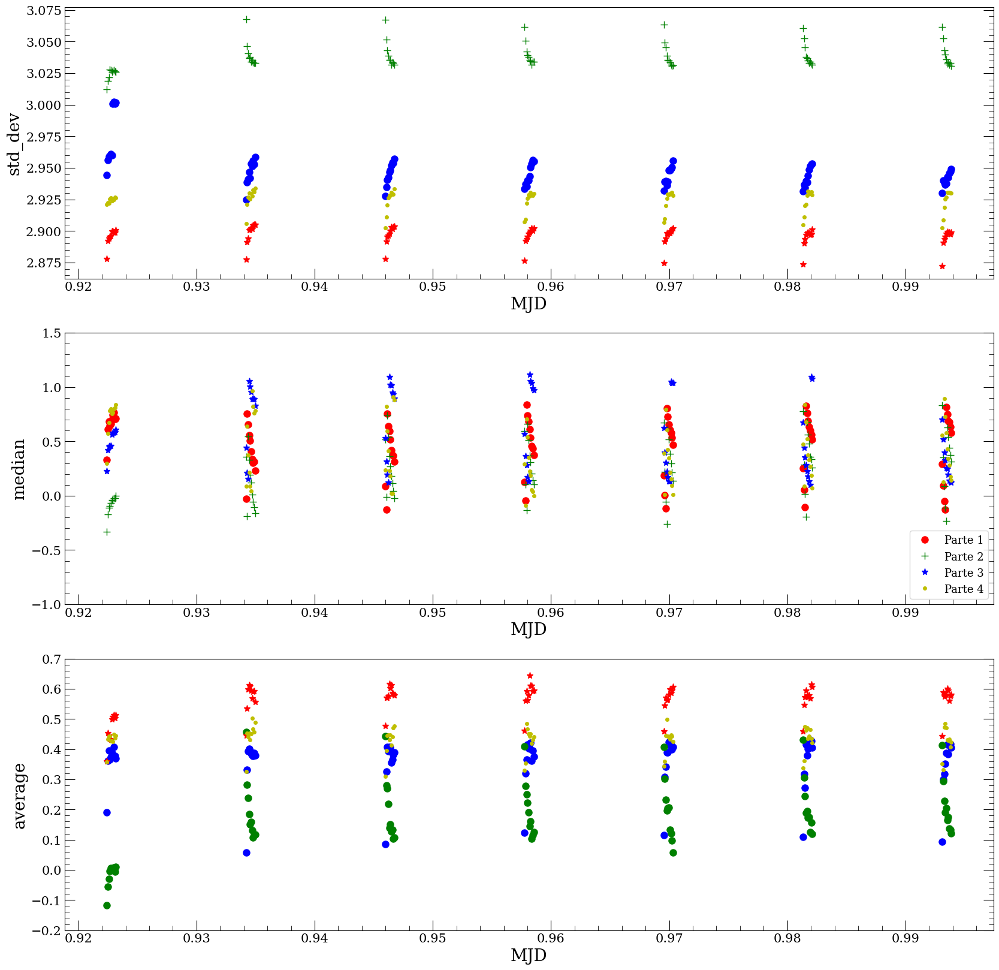

In [20]:
plt.figure(figsize=(20,20))

plt.subplot(311)
plt.plot(mjd1-60033, std_dev1, 'bo')
plt.plot(mjd2-60033, std_dev2, 'g+')
plt.plot(mjd3-60033, std_dev3, 'r*')
plt.plot(mjd4-60033, std_dev4, 'y.')
plt.xlabel('MJD')
plt.ylabel('std_dev')

plt.subplot(312)
plt.plot(mjd1-60033, median1, 'ro', label='Parte 1')
plt.plot(mjd2-60033, median2, 'g+', label='Parte 2')
plt.plot(mjd3-60033, median3, 'b*', label='Parte 3')
plt.plot(mjd4-60033, median4, 'y.', label='Parte 4')
plt.ylim(-1.0, 1.5)
plt.xlabel('MJD')
plt.ylabel('median')
plt.legend(loc=4, fontsize=13)

plt.subplot(313)
plt.plot(mjd1-60033, average1, 'bo')
plt.plot(mjd2-60033, average2, 'go')
plt.plot(mjd3-60033, average3, 'r*')
plt.plot(mjd4-60033, average4, 'y.')
plt.ylim(-0.2, 0.7)
plt.xlabel('MJD')
plt.ylabel('average')

plt.savefig('plot_01.pdf')
plt.show()


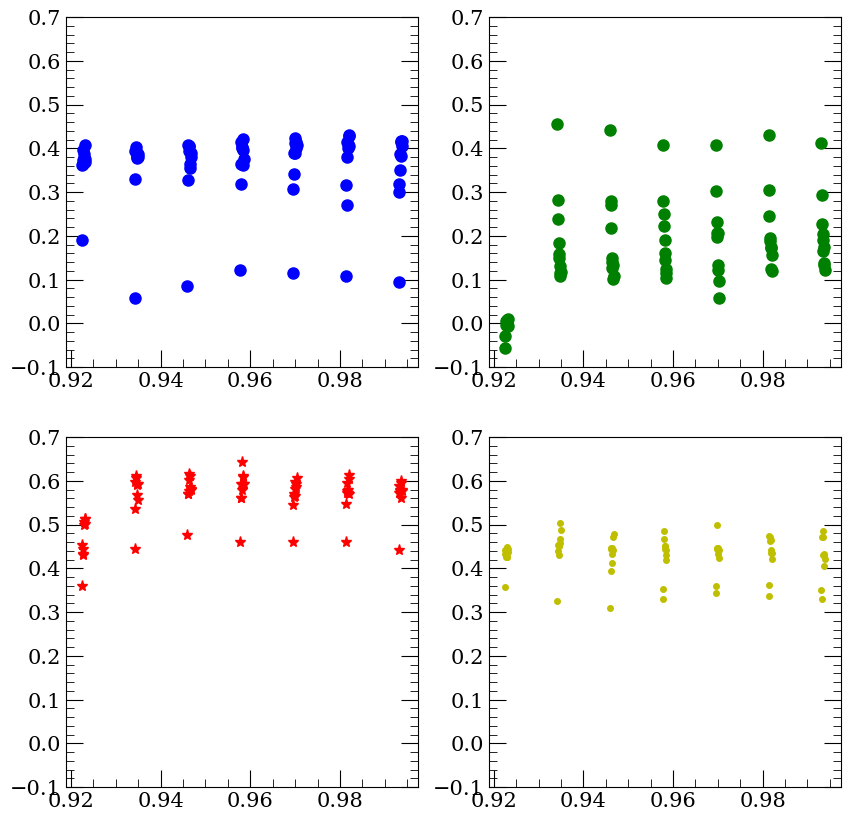

In [33]:
fig, axs = plt.subplots(2, 2, figsize=(10,10))

axs[0, 0].plot(mjd1-60033, average1, 'bo', label='Parte 1')
axs[0, 0].set_ylim(-0.1,0.7)

axs[0, 1].plot(mjd2-60033, average2, 'go', label='Parte 2')
axs[0, 1].set_ylim(-0.1,0.7)

axs[1, 0].plot(mjd3-60033, average3, 'r*', label='Parte 3')
axs[1, 0].set_ylim(-0.1,0.7)

axs[1, 1].plot(mjd4-60033, average4, 'y.', label='Parte 4')
axs[1, 1].set_ylim(-0.1,0.7)

plt.savefig('plot_01.pdf')
plt.show()